### Inventory, class balance and file integrity

  Domain        Class  Count Sample_Resolution  Percentage
0  Walls      Cracked   3751           256x256   20.909750
1  Walls  Non-Cracked  14188           256x256   79.090250
2  Decks      Cracked   1926           256x256   14.349575
3  Decks  Non-Cracked  11496           256x256   85.650425


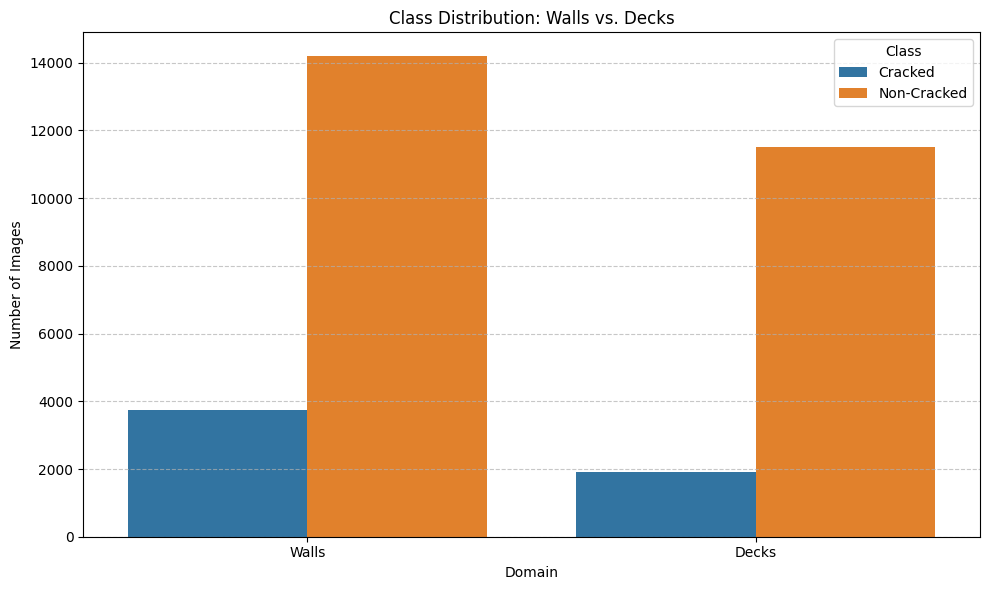

In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

# Define paths based on your local directory
base_path = r"C:\Users\Kritvi Gera\Desktop\ICL\Data Project\2. Image processing\Project_Vision_Data_Group_A\Project_Vision_Data_Group_A"

data_dirs = {
    "Walls": os.path.join(base_path, "Training_Pool_A_Walls"),
    "Decks": os.path.join(base_path, "Training_Pool_B_Decks")
}

categories = ["Cracked", "Non-Cracked"]
stats = []

for domain, root_dir in data_dirs.items():
    for cat in categories:
        path = os.path.join(root_dir, cat)
        if os.path.exists(path):
            files = [f for f in os.listdir(path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            
            # Basic Integrity Check: Check first image for dimensions
            sample_size = "N/A"
            if files:
                with Image.open(os.path.join(path, files[0])) as img:
                    sample_size = f"{img.size[0]}x{img.size[1]}"
            
            stats.append({
                "Domain": domain,
                "Class": cat,
                "Count": len(files),
                "Sample_Resolution": sample_size
            })
        else:
            print(f"⚠️  Path not found: {path}")

# Convert to DataFrame for easy analysis
df_audit = pd.DataFrame(stats)

if df_audit.empty:
    print("❌ No data found. Please check your folder names match exactly.")
else:
    # Calculate Imbalance Ratios
    df_audit['Percentage'] = df_audit.groupby('Domain')['Count'].transform(lambda x: (x / x.sum()) * 100)

    print(df_audit)

    # Visualizing Class Imbalance
    plt.figure(figsize=(10, 6))
    sns.barplot(data=df_audit, x='Domain', y='Count', hue='Class')
    plt.title("Class Distribution: Walls vs. Decks")
    plt.ylabel("Number of Images")
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

### Visual sampling 

Generate a grid of images for each category --> look for non-structural features that might confuse CNN --> observe visual differences between walls and decks 

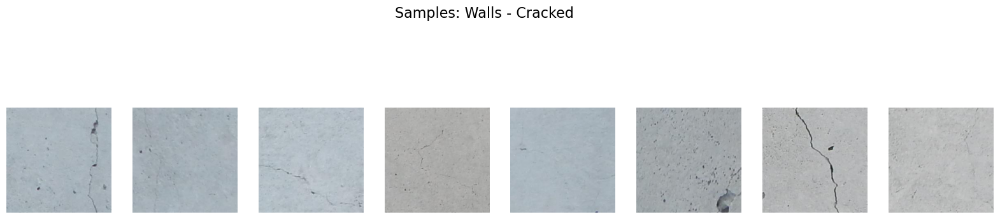

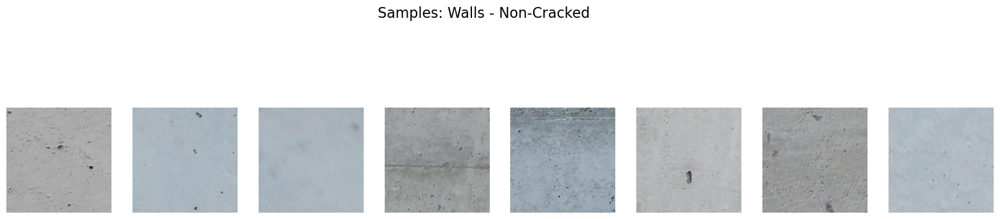

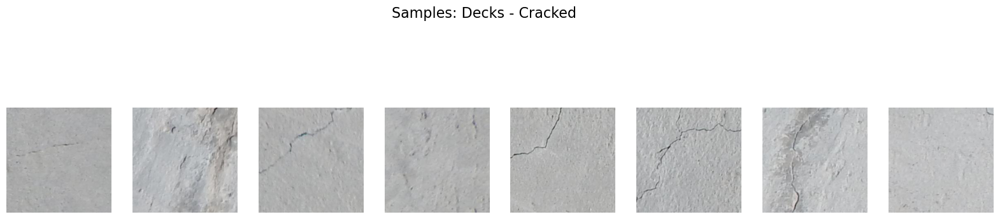

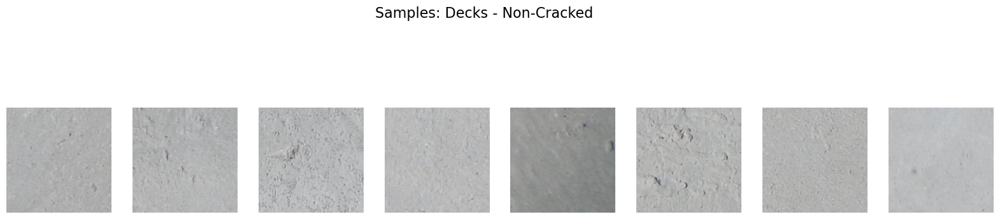

In [5]:
import numpy as np
import random

def plot_category_samples(domain, category, num_samples=8):
    path = os.path.join(data_dirs[domain], category)
    files = [f for f in os.listdir(path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    selected_files = random.sample(files, num_samples)
    
    fig, axes = plt.subplots(1, num_samples, figsize=(20, 5))
    fig.suptitle(f"Samples: {domain} - {category}", fontsize=16)
    
    for i, file in enumerate(selected_files):
        img_path = os.path.join(path, file)
        img = Image.open(img_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        # We can also print individual image stats if needed
    plt.show()

# Run for all combinations
for domain in data_dirs.keys():
    for cat in categories:
        plot_category_samples(domain, cat)


### Colour and luminance distribution analysis

- Calculate R,G,B, and Luminance for every image in the Training Pools

- Use data spread to see range of shadows and water stains

- Generate histograms


In [3]:
pip install opencv-python

   ---------------------------------------- 0.0/40.2 MB ? eta -:--:--
   - -------------------------------------- 1.3/40.2 MB 8.4 MB/s eta 0:00:05
   --- ------------------------------------ 3.1/40.2 MB 7.7 MB/s eta 0:00:05
   ---- ----------------------------------- 5.0/40.2 MB 8.2 MB/s eta 0:00:05
   ------- -------------------------------- 7.1/40.2 MB 8.6 MB/s eta 0:00:04
   -------- ------------------------------- 8.9/40.2 MB 8.8 MB/s eta 0:00:04
   ---------- ----------------------------- 11.0/40.2 MB 8.8 MB/s eta 0:00:04
   ------------ --------------------------- 12.8/40.2 MB 8.8 MB/s eta 0:00:04
   -------------- ------------------------- 14.7/40.2 MB 9.0 MB/s eta 0:00:03
   ---------------- ----------------------- 16.8/40.2 MB 9.0 MB/s eta 0:00:03
   ------------------ --------------------- 18.4/40.2 MB 8.9 MB/s eta 0:00:03
   -------------------- ------------------- 20.4/40.2 MB 8.9 MB/s eta 0:00:03
   ---------------------- ----------------- 22.3/40.2 MB 8.9 MB/s eta 0:00:03


[notice] A new release of pip is available: 25.3 -> 26.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Processing 3751 images for Walls - Cracked...
Processing 14188 images for Walls - Non-Cracked...
Processing 1926 images for Decks - Cracked...
Processing 11496 images for Decks - Non-Cracked...


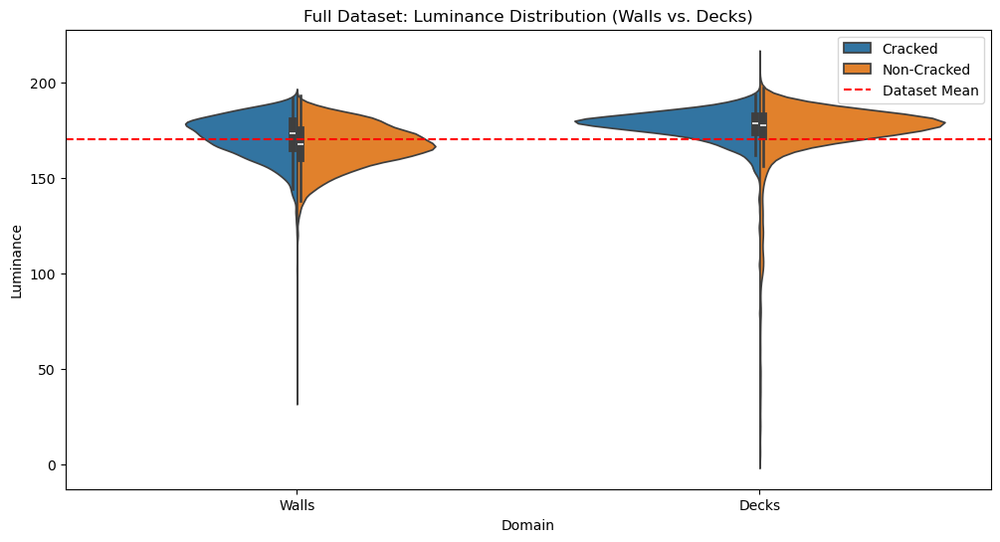

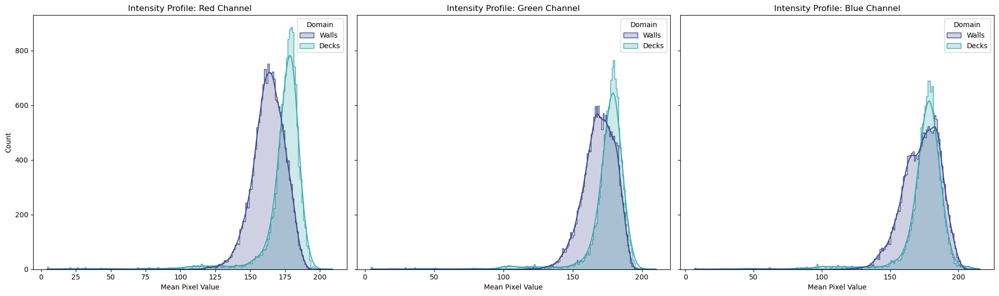


--- Summary Statistics (Full Dataset) ---
                      count        mean        std         min         25%  \
Domain Class                                                                 
Decks  Cracked       1926.0  177.276364   8.387594   79.161133  174.044754   
       Non-Cracked  11496.0  172.834294  21.095578    4.552597  171.702679   
Walls  Cracked       3751.0  171.621209  10.670146  102.021973  165.325615   
       Non-Cracked  14188.0  166.803113  11.469333   34.911087  160.115795   

                           50%         75%         max  
Domain Class                                            
Decks  Cracked      178.548836  182.257614  194.704269  
       Non-Cracked  177.419121  181.986343  210.127884  
Walls  Cracked      173.084427  179.591545  192.022995  
       Non-Cracked  167.380966  174.814404  193.123505  


In [10]:
def get_full_dataset_stats(domain, category):
    """
    Processes every image in the specified directory to extract 
    color and luminance statistics.
    """
    path = os.path.join(data_dirs[domain], category)
    files = [f for f in os.listdir(path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    
    means = []
    print(f"Processing {len(files)} images for {domain} - {category}...")
    
    for file in files:
        img_path = os.path.join(path, file)
        
        # Load image (OpenCV uses BGR by default)
        img = cv2.imread(img_path)
        if img is None:
            continue
            
        # Convert to Gray for luminance statistics
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        lum_mean = np.mean(gray)
        
        # Calculate mean for R, G, B (converting BGR to RGB logic)
        # Using mean(axis=(0,1)) is faster than calculating per channel manually
        b_mean, g_mean, r_mean = np.mean(img, axis=(0, 1))
        
        means.append([domain, category, r_mean, g_mean, b_mean, lum_mean])
        
    return means

# 1. Collect data from ALL images
all_stats = []
for domain in data_dirs.keys():
    for cat in categories:
        all_stats.extend(get_full_dataset_stats(domain, cat))

# 2. Convert to DataFrame
df_stats = pd.DataFrame(all_stats, columns=['Domain', 'Class', 'R_Mean', 'G_Mean', 'B_Mean', 'Luminance'])

# 3. Visualization: Full Dataset Luminance Distribution
plt.figure(figsize=(12, 6))
sns.violinplot(data=df_stats, x='Domain', y='Luminance', hue='Class', split=True)
plt.title("Full Dataset: Luminance Distribution (Walls vs. Decks)")
plt.axhline(df_stats['Luminance'].mean(), color='red', linestyle='--', label='Dataset Mean')
plt.legend()
plt.show()

# 4. Visualization: Full Dataset RGB Histogram (The "Shape" of your data)
fig, axes = plt.subplots(1, 3, figsize=(20, 6), sharey=True)
channel_cols = ['R_Mean', 'G_Mean', 'B_Mean']
channel_names = ['Red', 'Green', 'Blue']
colors = ['#e74c3c', '#2ecc71', '#3498db']

for i, col in enumerate(channel_cols):
    sns.histplot(data=df_stats, x=col, hue='Domain', kde=True, 
                 element="step", palette='mako', ax=axes[i])
    axes[i].set_title(f'Intensity Profile: {channel_names[i]} Channel')
    axes[i].set_xlabel('Mean Pixel Value')

plt.tight_layout()
plt.show()

print("\n--- Summary Statistics (Full Dataset) ---")
print(df_stats.groupby(['Domain', 'Class'])['Luminance'].describe())

- Decks show higher mean luminance compared to walls 

- Non-cracked decks show big s.d. and very small min luminance --> presence of deep shadows or deep water stains

- RGB Intensity profiles show very similar peaks and distributions --> justification to convert to grayscale?

- Cracked images have slightly higher mean luminance


### Texture and edge density analysis 

Use canny edge detection on dataset to see if we can distinguish between structural cracks and environmental noise

Percentage of edge pixels in every image is calculated to determine if cracked imgs have higher edge density than non-cracked ones

Calculating Edge Density for 3751 images in Walls - Cracked...
Calculating Edge Density for 14188 images in Walls - Non-Cracked...
Calculating Edge Density for 1926 images in Decks - Cracked...
Calculating Edge Density for 11496 images in Decks - Non-Cracked...


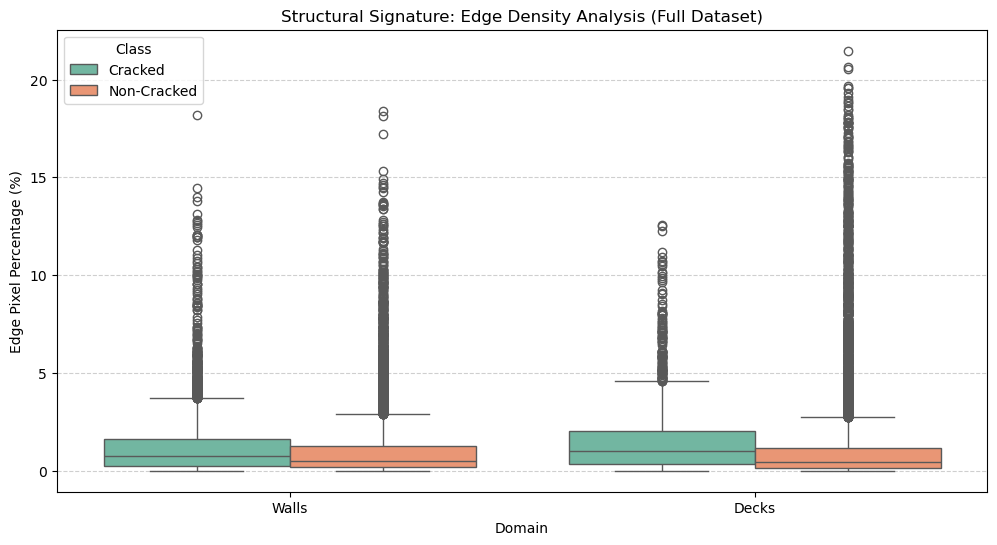


--- Edge Density Summary Statistics ---
                      count      mean       std  min       25%       50%  \
Domain Class                                                               
Decks  Cracked       1926.0  1.541188  1.766137  0.0  0.365067  1.011658   
       Non-Cracked  11496.0  1.233077  2.371697  0.0  0.135803  0.431824   
Walls  Cracked       3751.0  1.329452  1.756903  0.0  0.250244  0.747681   
       Non-Cracked  14188.0  1.056210  1.560040  0.0  0.172424  0.503540   

                         75%        max  
Domain Class                             
Decks  Cracked      2.050781  12.573242  
       Non-Cracked  1.176453  21.472168  
Walls  Cracked      1.634216  18.208313  
       Non-Cracked  1.269531  18.395996  


In [11]:
def get_full_edge_density(domain, category):
    """
    Applies Canny edge detection to every image in the dataset to 
    calculate the density of high-frequency structural features.
    """
    path = os.path.join(data_dirs[domain], category)
    files = [f for f in os.listdir(path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    
    edge_stats = []
    print(f"Calculating Edge Density for {len(files)} images in {domain} - {category}...")
    
    for file in files:
        img_path = os.path.join(path, file)
        
        # Load as grayscale directly for edge detection
        img = cv2.imread(img_path, 0)
        if img is None:
            continue
            
        # Apply Canny Edge Detection
        # Thresholds 100/200 are standard; can be tuned based on 'noise' findings
        edges = cv2.Canny(img, 100, 200)
        
        # Calculate density: (Number of edge pixels / Total pixels) * 100
        density = (np.sum(edges > 0) / (img.shape[0] * img.shape[1])) * 100
        edge_stats.append([domain, category, density])
        
    return edge_stats

# 1. Collect Edge Data from ALL images
edge_results = []
for domain in data_dirs.keys():
    for cat in categories:
        edge_results.extend(get_full_edge_density(domain, cat))

# 2. Convert to DataFrame
df_edges = pd.DataFrame(edge_results, columns=['Domain', 'Class', 'Edge_Density'])

# 3. Visualization: Edge Density Boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_edges, x='Domain', y='Edge_Density', hue='Class', palette="Set2")
plt.title("Structural Signature: Edge Density Analysis (Full Dataset)")
plt.ylabel("Edge Pixel Percentage (%)")
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()

# 4. Detailed Summary of Edge Distributions
print("\n--- Edge Density Summary Statistics ---")
print(df_edges.groupby(['Domain', 'Class'])['Edge_Density'].describe())

- cracked images show higher median edge density but IQR overlap significantly

- non-cracked decks contains extreme outliers e.g. 21.47%

- decks show slightly higher overall edge density than walls

- edge detection alone wont be useful for CNN 

Plotting values of R, B, G on top of images to check any spike or drop on top of the cracks

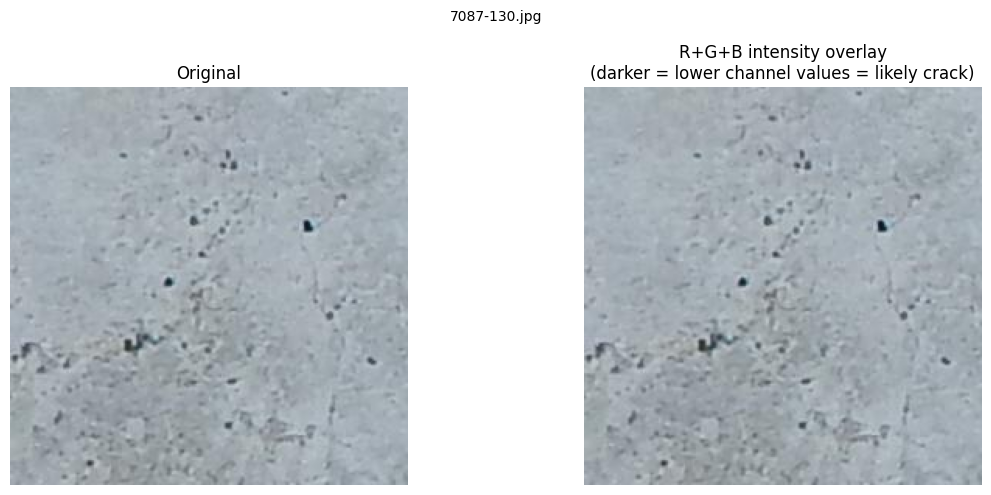

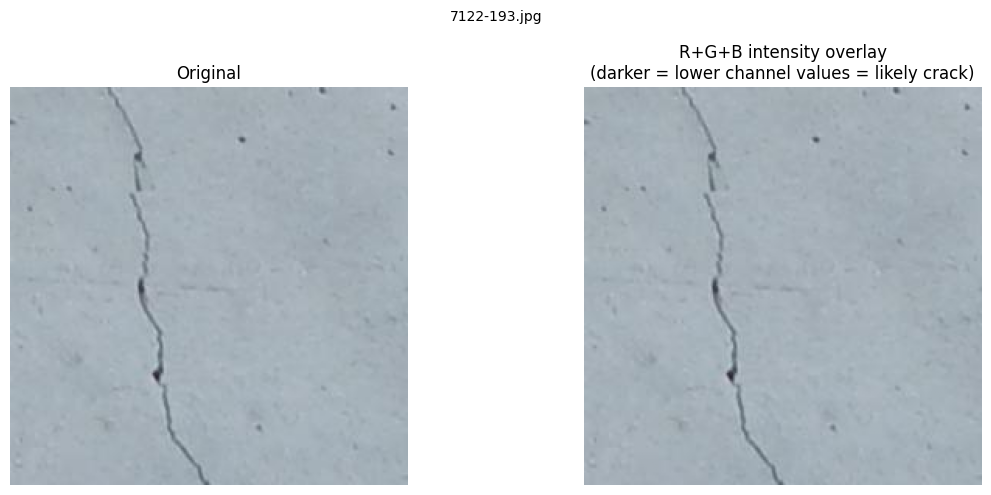

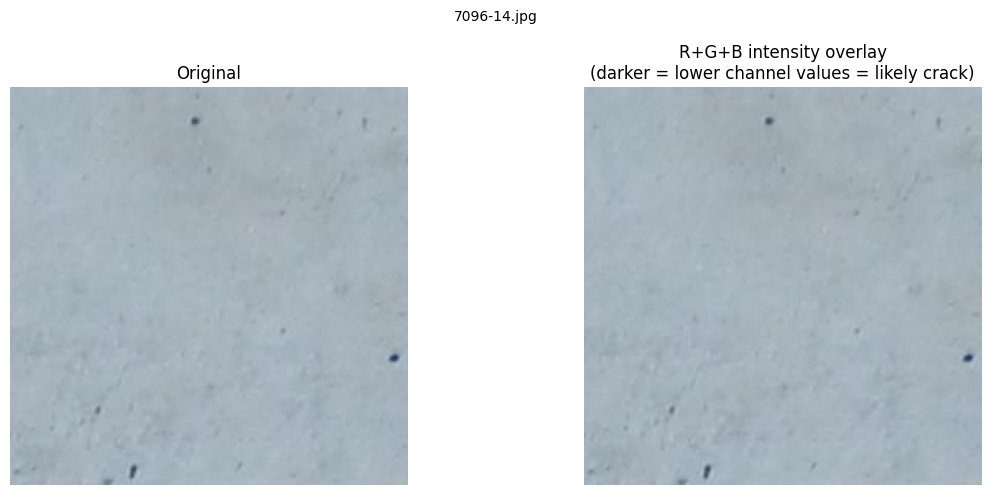

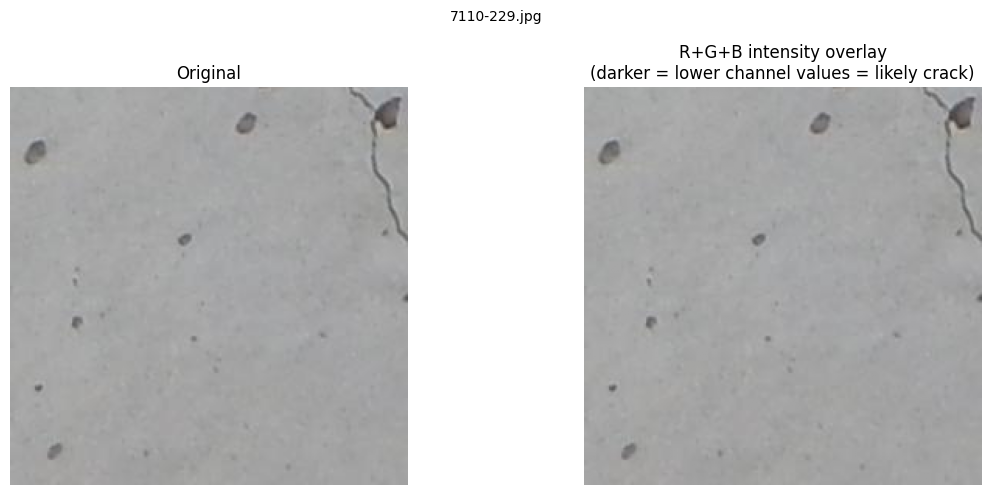

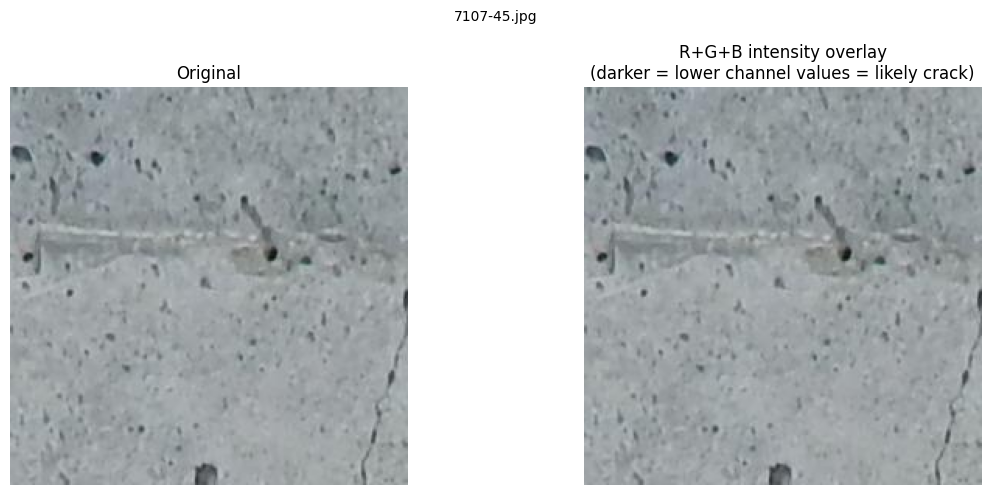

...

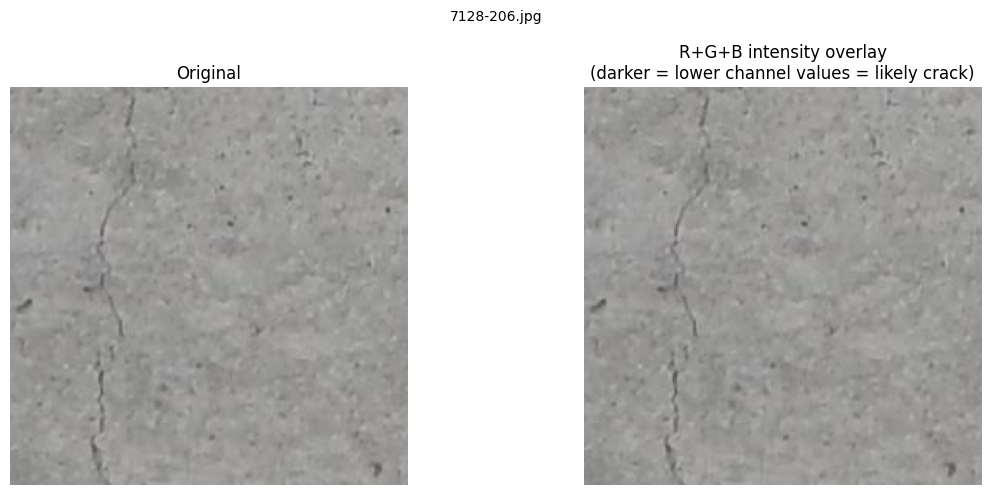

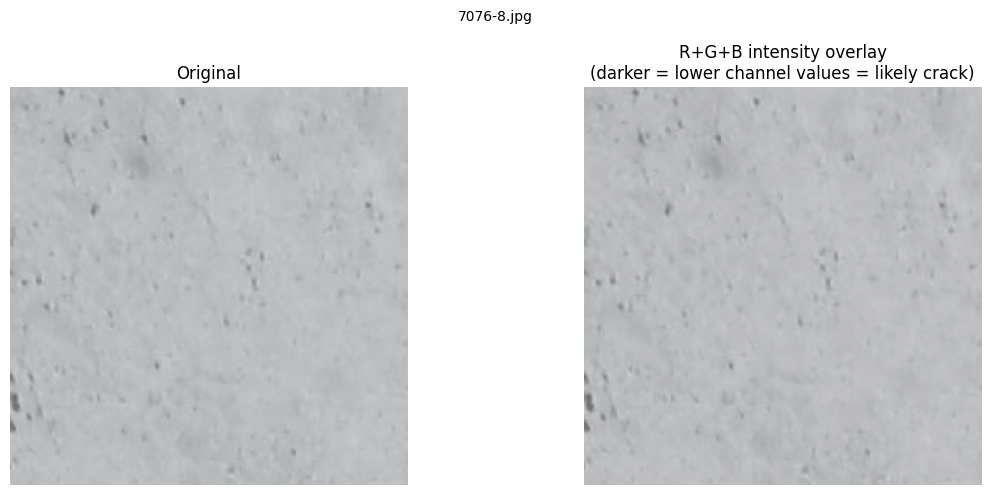

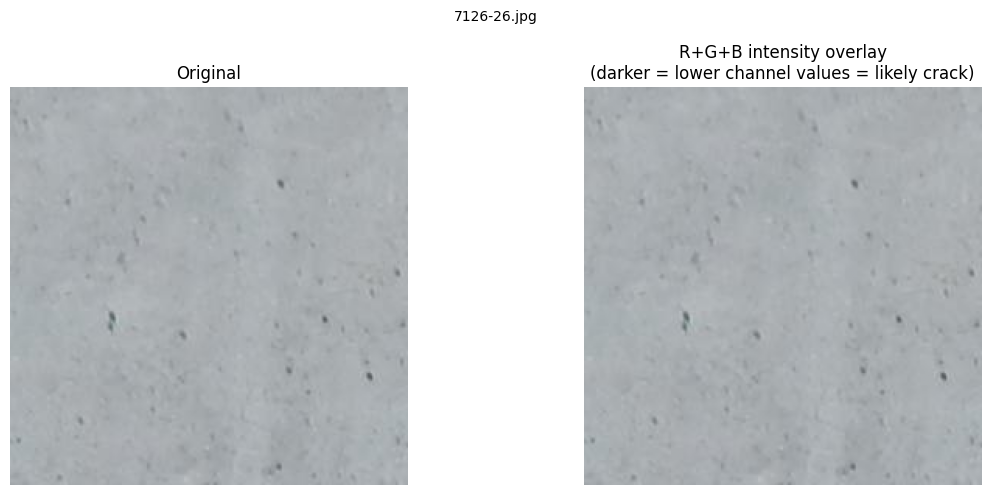

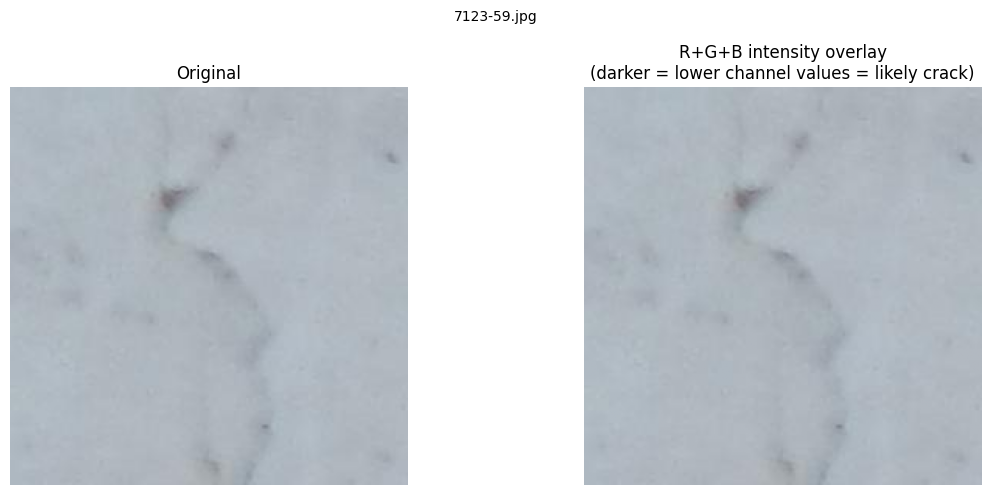

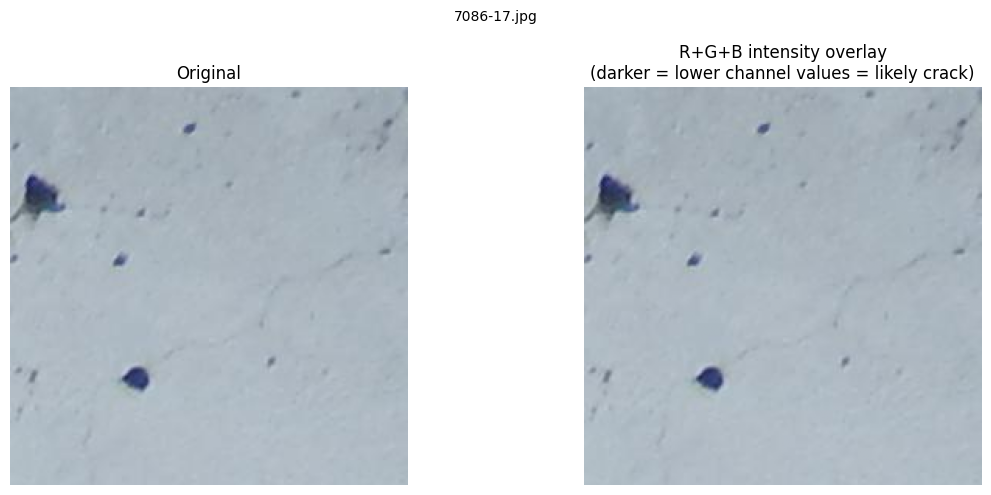

In [4]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# ── Path to Cracked Walls ──────────────────────────────────────────────────────
base_path = r"C:\Users\Kritvi Gera\Desktop\ICL\Data Project\2. Image processing\Project_Vision_Data_Group_A\Project_Vision_Data_Group_A"
cracked_walls_path = os.path.join(base_path, "Training_Pool_A_Walls", "Cracked")

# ── Pick 20 random images ──────────────────────────────────────────────────────
all_files = [f for f in os.listdir(cracked_walls_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
sample_files = random.sample(all_files, min(20, len(all_files)))

# ── Plot ───────────────────────────────────────────────────────────────────────
for fname in sample_files:
    img_path = os.path.join(cracked_walls_path, fname)
    img = np.array(Image.open(img_path).convert("RGB"))  # (256, 256, 3), values 0–255

    # ── Build a combined RGBA overlay image ──
    # Normalise each channel to 0–1
    R_norm = img[:, :, 0] / 255.0
    G_norm = img[:, :, 1] / 255.0
    B_norm = img[:, :, 2] / 255.0

    # Alpha per pixel = inverse of brightness → dark pixels (cracks) become MORE opaque
    # Bright pixels become nearly transparent so the original image shows through
    brightness = (R_norm + G_norm + B_norm) / 3.0
    alpha = (1.0 - brightness) ** 2   # square to sharpen the contrast; tweak exponent as needed
    alpha = np.clip(alpha, 0.0, 0.85) # cap max opacity so original is always partly visible

    # Stack into RGBA array (H, W, 4)
    overlay = np.dstack([R_norm, G_norm, B_norm, alpha])

    # ── Plot side by side: original | blended overlay ──
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(fname, fontsize=10)

    axes[0].imshow(img)
    axes[0].set_title("Original")
    axes[0].axis("off")

    axes[1].imshow(img)                          # base layer — full original
    axes[1].imshow(overlay)                      # translucent RGB colour plane on top
    axes[1].set_title("R+G+B intensity overlay\n(darker = lower channel values = likely crack)")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

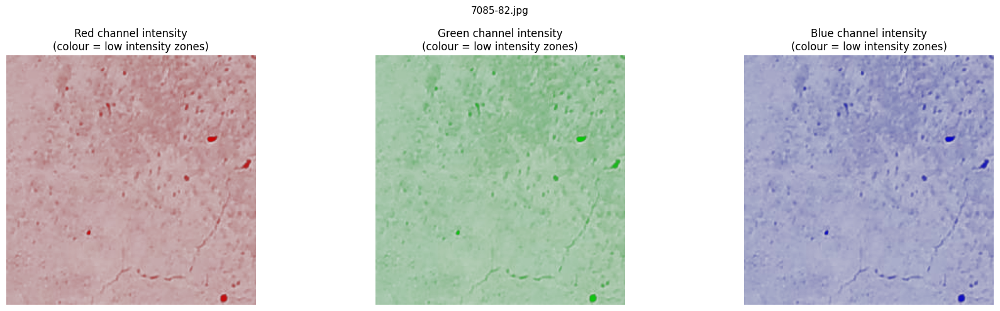

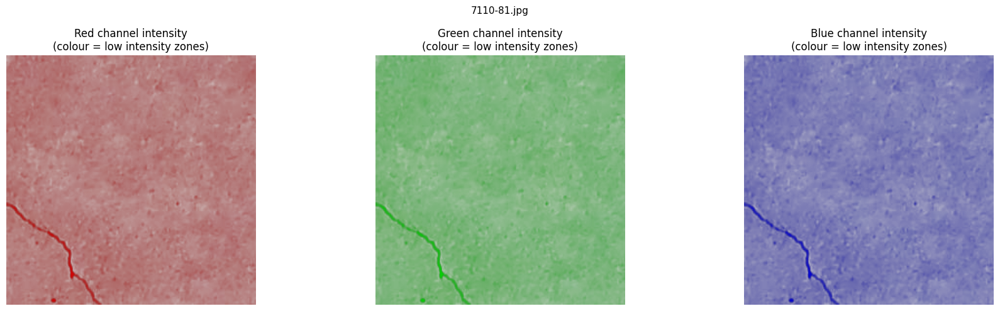

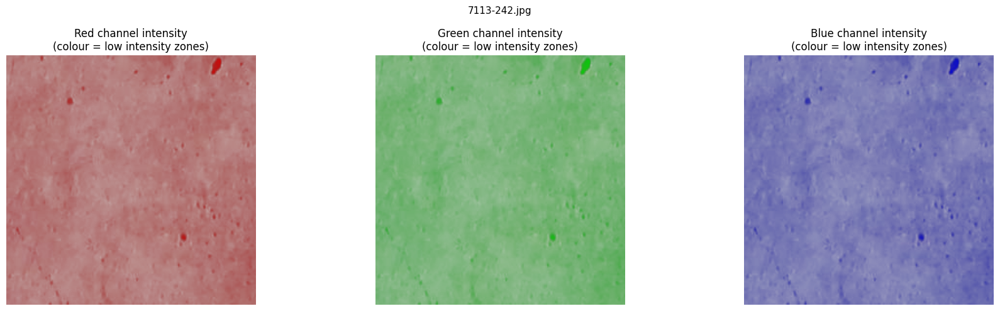

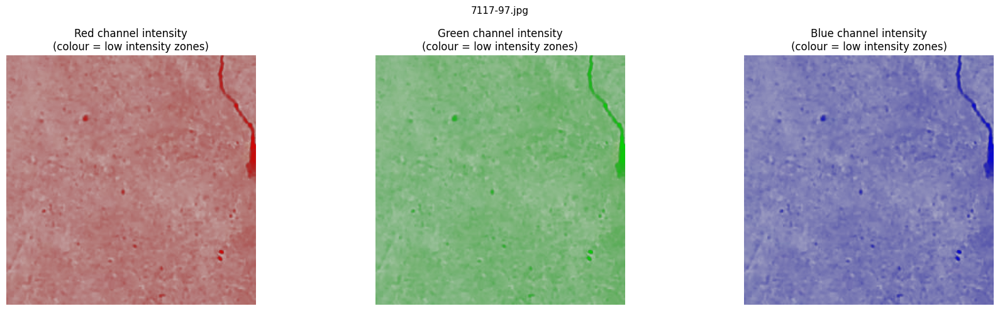

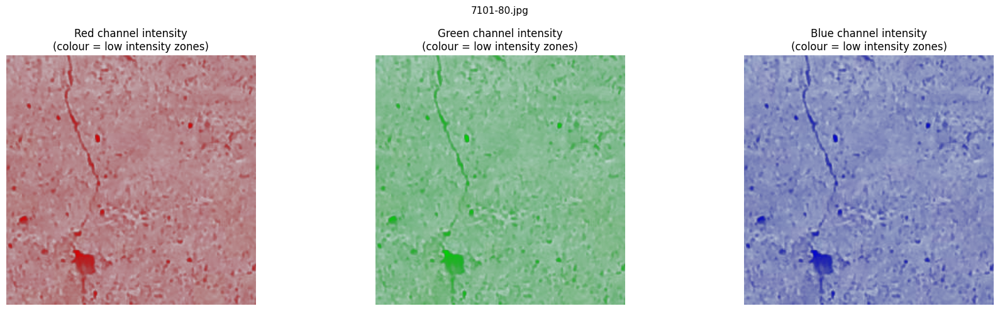

...

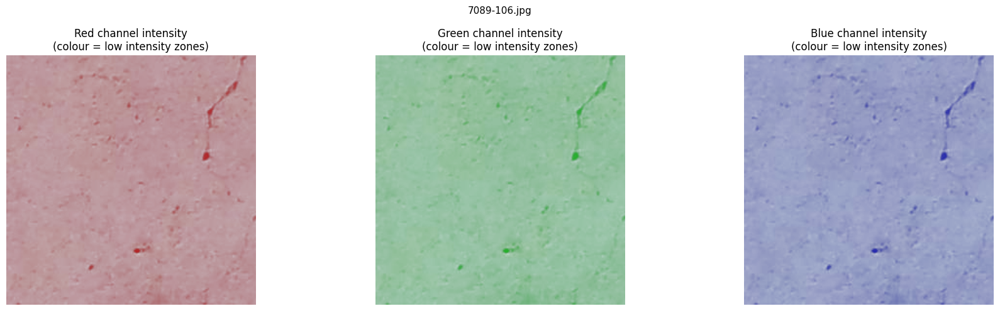

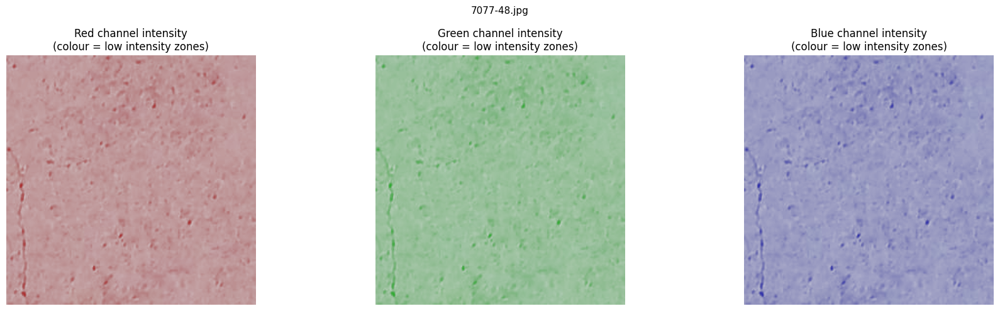

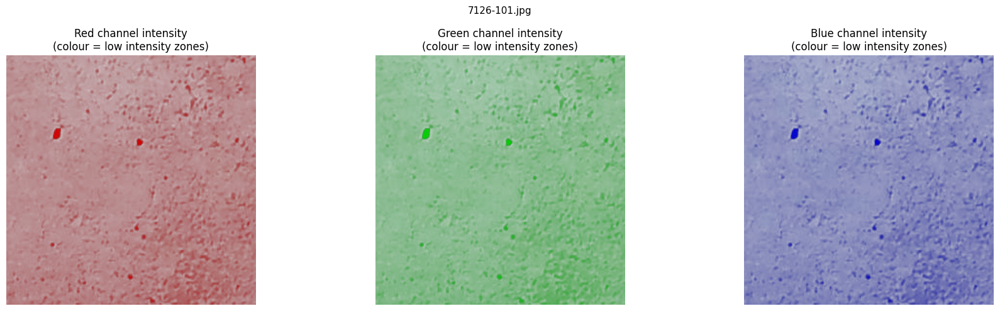

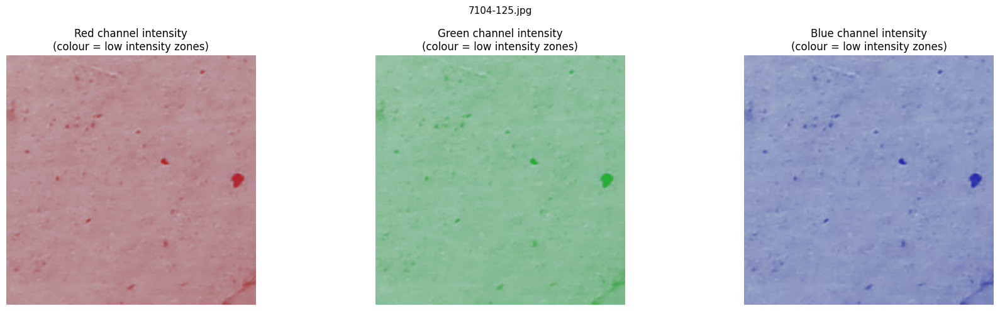

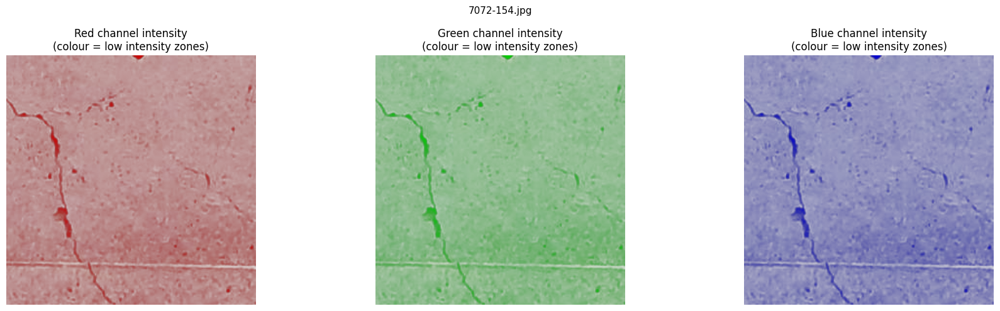

In [6]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# ── Path to Cracked Walls ──────────────────────────────────────────────────────
base_path = r"C:\Users\Kritvi Gera\Desktop\ICL\Data Project\2. Image processing\Project_Vision_Data_Group_A\Project_Vision_Data_Group_A"
cracked_walls_path = os.path.join(base_path, "Training_Pool_A_Walls", "Cracked")

# ── Pick 20 random images ──────────────────────────────────────────────────────
all_files = [f for f in os.listdir(cracked_walls_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
sample_files = random.sample(all_files, min(20, len(all_files)))

# ── Plot ───────────────────────────────────────────────────────────────────────
for fname in sample_files:
    img_path = os.path.join(cracked_walls_path, fname)
    img = np.array(Image.open(img_path).convert("RGB"))  # (256, 256, 3)

    channels = {
        "Red":   (img[:, :, 0], "Reds"),
        "Green": (img[:, :, 1], "Greens"),
        "Blue":  (img[:, :, 2], "Blues"),
    }

    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    fig.suptitle(fname, fontsize=11)

    for ax, (channel_name, (channel_data, cmap)) in zip(axes, channels.items()):
        # Base: original image
        ax.imshow(img)

        # Overlay: channel heatmap as a top-down plane, semi-transparent
        # Low intensity (dark = crack) → vivid colour; high intensity → fades out
        norm_data = channel_data / 255.0                    # 0–1
        alpha_map = (1.0 - norm_data) ** 1.5               # dark pixels more opaque
        alpha_map = np.clip(alpha_map, 0.0, 0.80)          # cap so image always shows through

        # Build RGBA image for this channel
        rgba = np.zeros((*channel_data.shape, 4), dtype=float)
        if channel_name == "Red":
            rgba[:, :, 0] = 1.0                            # pure red tint
        elif channel_name == "Green":
            rgba[:, :, 1] = 1.0                            # pure green tint
        elif channel_name == "Blue":
            rgba[:, :, 2] = 1.0                            # pure blue tint
        rgba[:, :, 3] = alpha_map                          # alpha driven by darkness

        ax.imshow(rgba)
        ax.set_title(f"{channel_name} channel intensity\n(colour = low intensity zones)")
        ax.axis("off")

    plt.tight_layout()
    plt.show()

In [7]:
"""
Image Processing Script
- Converts images to grayscale
- Applies contrast enhancement + unsharp mask sharpening for better line/edge detection
- Processes all images in the dataset folder structure, saving processed images
  alongside originals with a '_processed' suffix (or in a parallel output folder)

Usage:
    python process_images.py

Requirements:
    pip install Pillow opencv-python numpy
"""

import os
import cv2
import numpy as np
from pathlib import Path

# ── CONFIG ────────────────────────────────────────────────────────────────────

BASE_DIR = r"C:\Users\Kritvi Gera\Desktop\ICL\Data Project\2. Image processing\Project_Vision_Data_Group_A\Project_Vision_Data_Group_A"

# Where to save processed images.
# Options:
#   "alongside"  → saved next to originals with '_processed' suffix
#   "parallel"   → mirrored folder structure under BASE_DIR + "_Processed"
OUTPUT_MODE = "parallel"

# Supported image extensions
IMAGE_EXTENSIONS = {".jpg", ".jpeg", ".png", ".bmp", ".tiff", ".tif"}

# ── SHARPENING PARAMETERS (tweak these) ───────────────────────────────────────

# CLAHE (Contrast Limited Adaptive Histogram Equalization)
# Boosts local contrast to bring out cracks and edges
CLAHE_CLIP_LIMIT    = 3.0   # Higher = stronger contrast boost (try 2.0–5.0)
CLAHE_TILE_GRID     = (8, 8) # Grid size for local contrast regions

# Unsharp Mask sharpening  (kernel_size, sigma, amount, threshold)
UNSHARP_KERNEL_SIZE = (5, 5)  # Blur kernel (must be odd)
UNSHARP_SIGMA       = 1.0     # Gaussian blur sigma
UNSHARP_AMOUNT      = 1.5     # Sharpening strength (1.0 = subtle, 2.0+ = aggressive)
UNSHARP_THRESHOLD   = 0       # Minimum pixel diff to sharpen (0 = sharpen everything)

# ── HELPERS ───────────────────────────────────────────────────────────────────

def process_image(img_path: Path, out_path: Path):
    """Load image, convert to grayscale, enhance, save."""
    img = cv2.imread(str(img_path), cv2.IMREAD_UNCHANGED)
    if img is None:
        print(f"  [SKIP] Could not read: {img_path.name}")
        return False

    # 1. Convert to grayscale
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        gray = img.copy()

    # 2. CLAHE – adaptive contrast enhancement (helps reveal cracks)
    clahe = cv2.createCLAHE(
        clipLimit=CLAHE_CLIP_LIMIT,
        tileGridSize=CLAHE_TILE_GRID
    )
    enhanced = clahe.apply(gray)

    # 3. Unsharp mask – sharpens edges / lines
    blurred = cv2.GaussianBlur(enhanced, UNSHARP_KERNEL_SIZE, UNSHARP_SIGMA)
    sharpened = cv2.addWeighted(
        enhanced, 1 + UNSHARP_AMOUNT,
        blurred,  -UNSHARP_AMOUNT,
        0
    )
    if UNSHARP_THRESHOLD > 0:
        diff = np.abs(sharpened.astype(int) - enhanced.astype(int))
        sharpened = np.where(diff < UNSHARP_THRESHOLD, enhanced, sharpened).astype(np.uint8)

    # 4. Save
    out_path.parent.mkdir(parents=True, exist_ok=True)
    cv2.imwrite(str(out_path), sharpened)
    return True


def get_output_path(img_path: Path, base_dir: Path) -> Path:
    rel = img_path.relative_to(base_dir)
    if OUTPUT_MODE == "alongside":
        return img_path.parent / (img_path.stem + "_processed" + img_path.suffix)
    else:  # parallel
        out_base = base_dir.parent / (base_dir.name + "_Processed")
        return out_base / rel


# ── MAIN ──────────────────────────────────────────────────────────────────────

def main():
    base = Path(BASE_DIR)
    if not base.exists():
        print(f"ERROR: Base directory not found:\n  {BASE_DIR}")
        return

    all_images = [
        p for p in base.rglob("*")
        if p.is_file() and p.suffix.lower() in IMAGE_EXTENSIONS
    ]

    if not all_images:
        print("No images found. Check BASE_DIR and IMAGE_EXTENSIONS.")
        return

    print(f"Found {len(all_images)} image(s) to process...\n")

    ok = fail = 0
    for img_path in sorted(all_images):
        out_path = get_output_path(img_path, base)
        rel_display = img_path.relative_to(base)
        print(f"  Processing: {rel_display}")
        if process_image(img_path, out_path):
            ok += 1
        else:
            fail += 1

    print(f"\n✅ Done!  {ok} processed,  {fail} skipped.")
    if OUTPUT_MODE == "parallel":
        out_base = base.parent / (base.name + "_Processed")
        print(f"Output folder: {out_base}")


if __name__ == "__main__":
    main()

Found 32061 image(s) to process...

  Processing: Mystery_Test_Set\img_test_0000.jpg
  Processing: Mystery_Test_Set\img_test_0001.jpg
  Processing: Mystery_Test_Set\img_test_0002.jpg
  Processing: Mystery_Test_Set\img_test_0003.jpg
  Processing: Mystery_Test_Set\img_test_0004.jpg
  Processing: Mystery_Test_Set\img_test_0005.jpg
  Processing: Mystery_Test_Set\img_test_0006.jpg
  Processing: Mystery_Test_Set\img_test_0007.jpg
  Processing: Mystery_Test_Set\img_test_0008.jpg
  Processing: Mystery_Test_Set\img_test_0009.jpg
  Processing: Mystery_Test_Set\img_test_0010.jpg
  Processing: Mystery_Test_Set\img_test_0011.jpg
  Processing: Mystery_Test_Set\img_test_0012.jpg
  Processing: Mystery_Test_Set\img_test_0013.jpg
  Processing: Mystery_Test_Set\img_test_0014.jpg
  Processing: Mystery_Test_Set\img_test_0015.jpg
  Processing: Mystery_Test_Set\img_test_0016.jpg
  Processing: Mystery_Test_Set\img_test_0017.jpg
  Processing: Mystery_Test_Set\img_test_0018.jpg
  Processing: Mystery_Test_Set\im